In [1]:
import torch as torch
import cv2
import numpy as np
import matplotlib.cm as cm
# from kornia import make_matching_figure
import glob
import matplotlib.pyplot as plt
from featureMatcher import matchFeaturesLOFTR, matchFeaturesHardnet
from featureMatcher import drawMatches, drawMatchesVertical



In [2]:
imagePaths = glob.glob(f'./LenaStreetLofts/*.jpg')
imagePaths.sort()
print(imagePaths)

['./LenaStreetLofts/Street View 360_0000_35.66537491_-105.96326669_2100_149.jpg', './LenaStreetLofts/Street View 360_0001_35.66539817_-105.96284131_2100_331.jpg', './LenaStreetLofts/Street View 360_0002_35.66529155_-105.96333133_2099_138.jpg', './LenaStreetLofts/Street View 360_0003_35.66545296_-105.96321120_2100_150.jpg', './LenaStreetLofts/Street View 360_0004_35.66527493_-105.96378863_2099_100.jpg', './LenaStreetLofts/Street View 360_0005_35.66526338_-105.96367119_2099_85.jpg', './LenaStreetLofts/Street View 360_0006_35.66525468_-105.96355787_2099_85.jpg', './LenaStreetLofts/Street View 360_0007_35.66525052_-105.96343801_2099_89.jpg', './LenaStreetLofts/Street View 360_0008_35.66556017_-105.96314683_2100_164.jpg', './LenaStreetLofts/Street View 360_0009_35.66555856_-105.96328292_2100_290.jpg', './LenaStreetLofts/Street View 360_0010_35.66553406_-105.96339355_2100_273.jpg', './LenaStreetLofts/Street View 360_0011_35.66553147_-105.96350857_2100_270.jpg', './LenaStreetLofts/Street View

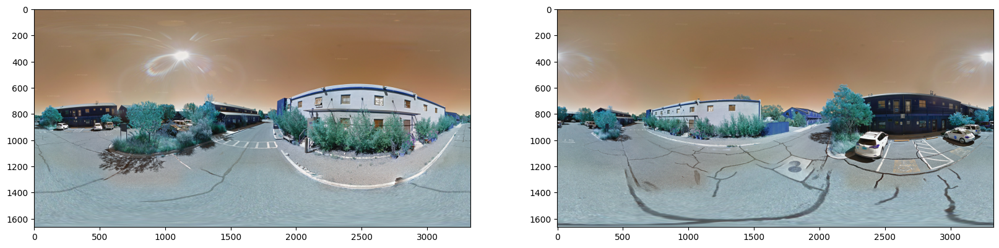

In [3]:
filename1 = imagePaths[9]#'LenaStreetLofts/Street View 360_0005_35.66526338_-105.96367119_2099_85.jpg'
filename2 = imagePaths[8]#'LenaStreetLofts/Street View 360_0006_35.66525468_-105.96355787_2099_85.jpg'

img1 = cv2.imread(filename1)
img2 = cv2.imread(filename2)

fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(20, 10))
ax1.imshow(img1)
ax2.imshow(img2)
plt.show()


In [4]:
kpts1, kpts2, confidences = matchFeaturesLOFTR(img1, img2, pretrainedName='outdoor')

kpts1HighThresh = kpts1[confidences > 0.4]
kpts2HighThresh = kpts2[confidences > 0.4]



img1 to grayscale
img2 to grayscale
(640, 640) (1664, 3328)
dict_keys(['keypoints0', 'keypoints1', 'confidence', 'batch_indexes'])


In [5]:
bothPts = zip(kpts1HighThresh , kpts2HighThresh )
# filter out points that are too close to each other
bothPts2 = np.array(list(filter(lambda x: np.linalg.norm(x[0] - x[1]) > 10, bothPts)))
# print(bothPts2[:,0,:])
kpts1Good = bothPts2[:,0,:]
kpts2Good = bothPts2[:,1,:]

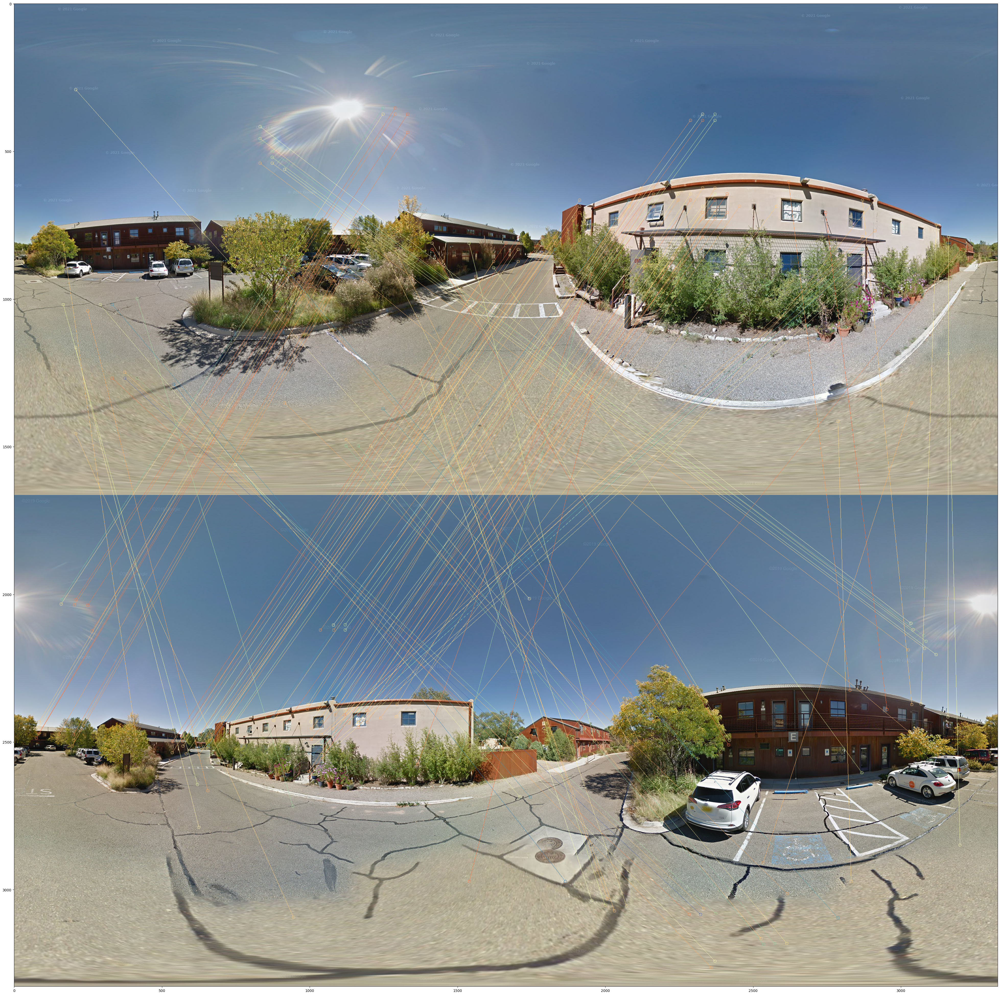

In [6]:
imgMatch = drawMatchesVertical(cv2.cvtColor(img1,cv2.COLOR_BGR2RGB) , cv2.cvtColor(img2,cv2.COLOR_BGR2RGB), kpts1Good, kpts2Good, confidences)
fig, (ax1) = plt.subplots(nrows=1, ncols=1, figsize=(50,50))
ax1.imshow(imgMatch)
plt.show()

In [7]:
print(kpts1.shape, kpts2.shape)



(375, 2) (375, 2)


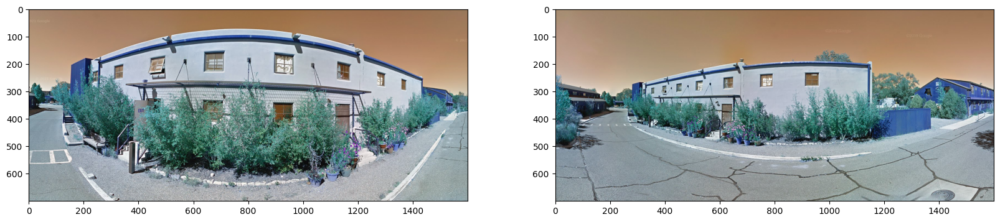

In [8]:
# try on a small section of the image
img1s = img1[500:1200, 1700:3300,:]
img2s = img2[500:1200, 400:2000,:]

fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(20, 10))
ax1.imshow(img1s)
ax2.imshow(img2s)



In [9]:
# kpts1_s, kpts2_s, confidences_s = matchFeaturesLOFTR(img1s, img2s, pretrainedName='outdoor')

# kpts1HighThresh_s = kpts1[confidences > 0.6]
# kpts2HighThresh_s = kpts2[confidences > 0.6]
# bothPts_s = zip(kpts1HighThresh_s , kpts2HighThresh_s )
# # filter out points that are too close to each other
# bothPts2_s = np.array(list(filter(lambda x: np.linalg.norm(x[0] - x[1]) > 10, bothPts_s)))
# # print(bothPts2[:,0,:])
# kpts1Good_s = bothPts2_s[:,0,:]
# kpts2Good_s = bothPts2_s[:,1,:]
# imgMatch = drawMatchesVertical(cv2.cvtColor(img1s,cv2.COLOR_BGR2RGB) , cv2.cvtColor(img2s,cv2.COLOR_BGR2RGB), kpts1Good_s, kpts2Good_s, confidences_s)
# fig, (ax1) = plt.subplots(nrows=1, ncols=1, figsize=(10,10))
# ax1.imshow(imgMatch)
#plt.show()

## Try CV2 sift points

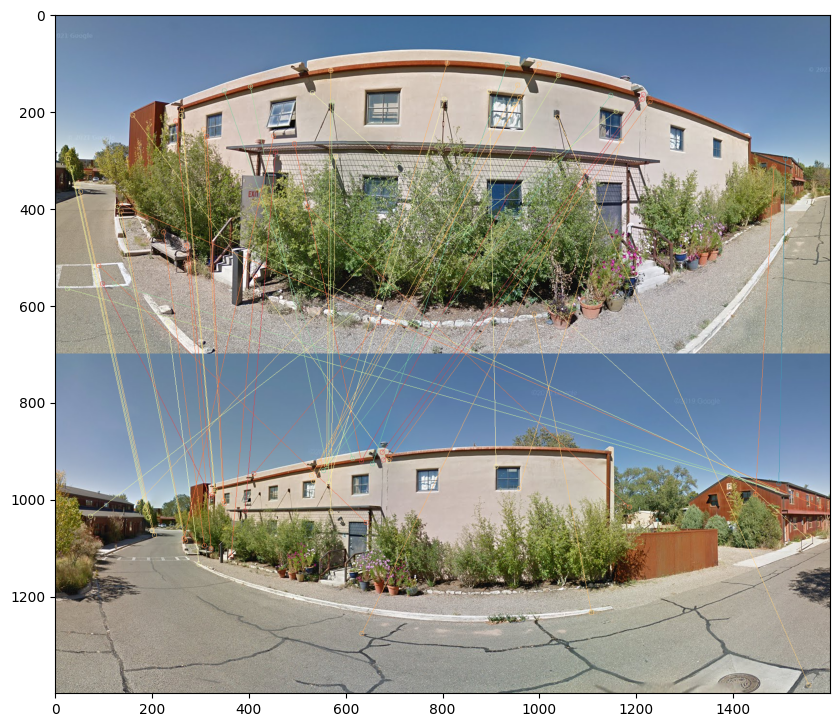

In [10]:


MIN_MATCH_COUNT = 10

# Initiate SIFT detector
sift = cv2.SIFT_create()
# find the keypoints and descriptors with SIFT
kp1, des1 = sift.detectAndCompute(img1s,None)
kp2, des2 = sift.detectAndCompute(img2s,None)
FLANN_INDEX_KDTREE = 1
index_params = dict(algorithm = FLANN_INDEX_KDTREE, trees = 5)
search_params = dict(checks = 50)
flann = cv2.FlannBasedMatcher(index_params, search_params)
matches = flann.knnMatch(des1,des2,k=2)
# store all the good matches as per Lowe's ratio test.
goodList = []
for m,n in matches:
    if m.distance < 0.7*n.distance:
        goodList.append(m)


src_pts = np.float32([ kp1[m.queryIdx].pt for m in goodList ])
dst_pts = np.float32([ kp2[m.trainIdx].pt for m in goodList ])
confidences = np.array([ m.distance for m in goodList ])
confidences = 1 - confidences / np.max(confidences)

src_pts = src_pts[confidences > 0]
dst_pts = dst_pts[confidences > 0]
confidences = confidences[confidences > 0]

siftFeatures = drawMatchesVertical(cv2.cvtColor(img1s, cv2.COLOR_BGR2RGB), cv2.cvtColor(img2s, cv2.COLOR_BGR2RGB),src_pts,dst_pts,confidences)
fig , ax = plt.subplots(1,1,figsize=(10,10))
ax.imshow(siftFeatures)

## Try the hardNET feature matcher. oooh. 

In [11]:
from featureMatcher import matchFeaturesHardnet

pts1Hard, pts2Hard, confHard = matchFeaturesHardnet(img1s, img2s)


img1 to grayscale
img2 to grayscale
(640, 640) (700, 1600)
dict_keys(['keypoints0', 'keypoints1', 'lafs0', 'lafs1', 'confidence', 'batch_indexes'])


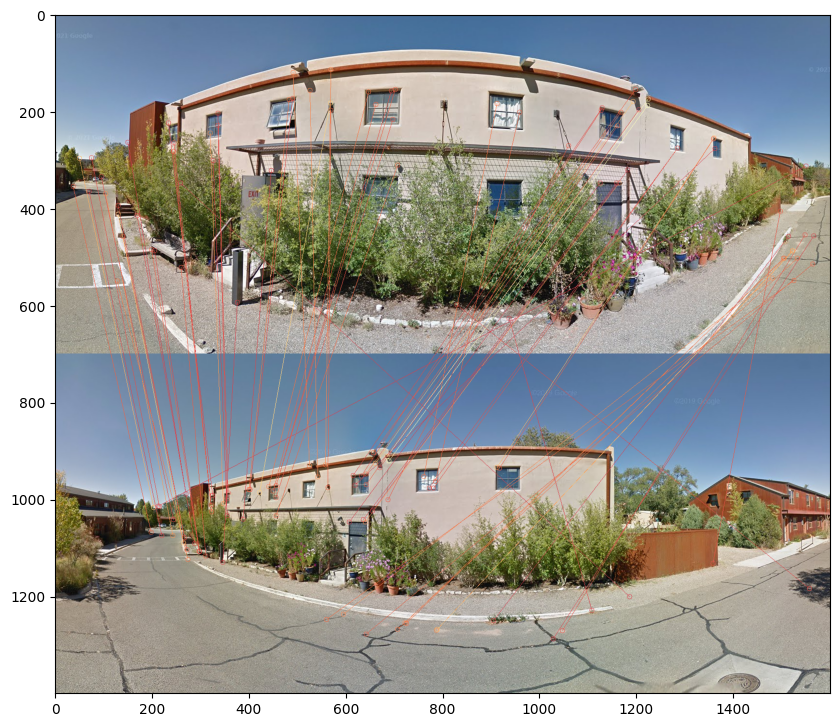

In [12]:
matchImage = drawMatchesVertical(cv2.cvtColor(img1s, cv2.COLOR_BGR2RGB), cv2.cvtColor(img2s, cv2.COLOR_BGR2RGB), pts1Hard, pts2Hard, confHard)
fig, ax1 = plt.subplots(1,1, figsize=(10,10))
ax1.imshow(matchImage)
